<h1 style="text-align: center;">Data analysis</h1>

<em><strong>Note:</strong><br>
This notebook is part of a project about the French counties and house prices. Please read the <a href=" https://github.com/Ashish-3/House-prices-in-France/blob/master/Readme.md">readme</a> file for more information:</em>



In this notebook we will use pre-processed data about the communes and Foursquare's database to find a 'good place' to buy a house in France.

## Importing libraries

In [1]:
import numpy as np  # useful for many scientific computing in Python
import pandas as pd # primary data structure library

#show all the columns of a data
pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', 500)

# Matplotlib and associated plotting modules
import matplotlib.cm as cm
import matplotlib.colors as colors
import matplotlib.pyplot as plt
import seaborn as sns

import folium
from folium import plugins

import time
import math

In [2]:
from __future__ import print_function
from ipywidgets import interact, interactive, fixed, interact_manual
import ipywidgets as widgets

In [3]:
import os
import io
import PIL.Image as Image

## Importing pre-processed data

Let's import the geojson fils containing the border of the communes and the pre-processed data. We will focus this study on four features of the Communes:
    - Price of houses ('Prix_m2')
    - Median age of the population ('age_median')
    - Median standard of living of housholds ('revenue_median')
    - Density of the populaiton ('density')

In [4]:
communes_borders = r'data/COPYSANSVILLEcommunes-version-simplifiee.geojson'

In [5]:
df=pd.read_csv(r'all_data_immo.csv')
df=df[~df['Code INSEE'].isna()]
print(df.shape)
df.head()

(36769, 29)


,Code INSEE,Code Postal,Commune,Code Département,Code Région,Superficie_km2,lat,lng,age_mean,age_std,age_median,population,merge1,Fhousehold,person_p_Fhousehold,revenue_median,revenue_inequalities,merge2,density,Valeur fonciere,Code postal,Code commune,Code type local,Nombre pieces principales,Surface terrain,Surface Carrez,Prix_m2,N,_merge
0,59276,59287,GUESNAIN,59,31.0,4.05,50.348346,3.148167,40.851860,24.642605,41.0,4651.0,both,1884.0,4624.0,17270.0,2.6,both,1148.395062,126111.978261,59287.0,276.0,1.0,4.391304,410.869565,93.391304,1368.677765,138.0,both
1,88128,88210,DENIPAIRE,88,41.0,7.02,48.339817,6.961893,43.832158,22.810009,48.0,246.0,both,108.0,246.0,21720.0,NaN,both,35.042735,98260.000000,88210.0,128.0,1.0,4.400000,456.400000,99.200000,1002.946560,5.0,both
2,57538,57170,PETTONCOURT,57,41.0,4.93,48.788126,6.411069,40.315972,23.739636,41.0,288.0,both,109.0,298.0,20970.0,NaN,both,58.417850,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,left_only
3,54459,54630,RICHARDMENIL,54,41.0,7.07,48.595865,6.176145,46.335881,23.049189,51.0,2358.0,both,1020.0,2395.0,25960.0,2.4,both,333.521924,201593.181818,54630.0,459.0,1.0,4.738636,493.113636,107.909091,1924.344829,88.0,both
4,35022,35190,BECHEREL,35,53.0,0.55,48.296509,-1.942824,41.722078,25.144570,42.0,673.0,both,293.0,632.0,19260.0,NaN,both,1223.636364,142893.235294,35190.0,22.0,1.0,4.823529,327.500000,117.735294,1239.205157,34.0,both


## Visualizing the data on a map

To have a better understanding of the data we will plot it on a choropleth map. This will allow us to better visualize how the different variables such as,  demography, standard of living and real estate prices evolve across the French territory. We will use the Folium library to do so. 

The choropleth class object of Folium lack some features for plotting the legend on a map. In our case, the legend appears to crowded and can't be read. For this project we will just remove the legend to save time, but more work can be done to generate proper maps. 

First we create a function to remove the automaticly generated legend of Folium choropleth objects:

In [6]:
# Defining a function to remove the legend on an choropleth object
def folium_del_legend(choropleth) :
    del_list = []
    for child in choropleth._children:
        if child.startswith('color_map'):
            del_list.append(child)

    for del_item in del_list:
        choropleth._children.pop(del_item)

    return choropleth

Then we define the variables that are going to be used for plotting the map :

In [7]:
# Defining the feature of 'df' to plot on the choropleth map
feature='revenue_median'

# Define the title of the map
title_text='Representation of the feature : {}'.format(feature)

# Define the bins to plot the choropleth
q0, q1, q2, q3, q4, q5 =  0, 0.25, 0.5, 0.75, 0.95, 1
bins=[df[feature].quantile(q=q0),
      df[feature].quantile(q=q1),
      df[feature].quantile(q=q2),
      df[feature].quantile(q=q3),
      df[feature].quantile(q=q4),
      df[feature].quantile(q=q5)
     ]

# Define a text that displays the bins on the map
bin_text='Bins used : {}'.format(str(list(int(round(bin,0)) for bin in bins)))

print(bin_text)


Bins used : [11070, 19320, 20760, 22560, 26330, 48310]


Let's plot the map using the Folium library and the previously defined variables and functions :

In [8]:
# Initialize a map to the center of France
map_france = folium.Map(location=[46.970810, 2.564210], zoom_start=7)

# Create a choropleth object
choropleth=folium.Choropleth(geo_data=communes_borders,
                  data=df,
                  columns=['Code INSEE',feature],
                  key_on='feature.properties.code',
                  bins=bins,
                  line_weight=0.1,
                  fill_opacity=0.6,
                  nan_fill_color='black',
                  nan_fill_opacity=0.6,
                  highlight=False,
                  smooth_factor=1,
                 )

# Use the function defined previously to remove the legend from the objet and add the object to map_france
folium_del_legend(choropleth).add_to(map_france)

# Add a title to the map
title_html = '''
             <h3 align="center" style="font-size:16px"><b>{}</b></h3>
             '''.format(title_text)
map_france.get_root().html.add_child(folium.Element(title_html))

# Display bin values and warning message because of the size of the map
display_html = '''
             <p align="right" style="font-size:10">{}  (Warning : the map is heavy and may take time to load)</p>
             '''.format(bin_text) 
map_france.get_root().html.add_child(folium.Element(display_html))

map_france

Those functions allow us to save the map in a PNG image and html file:

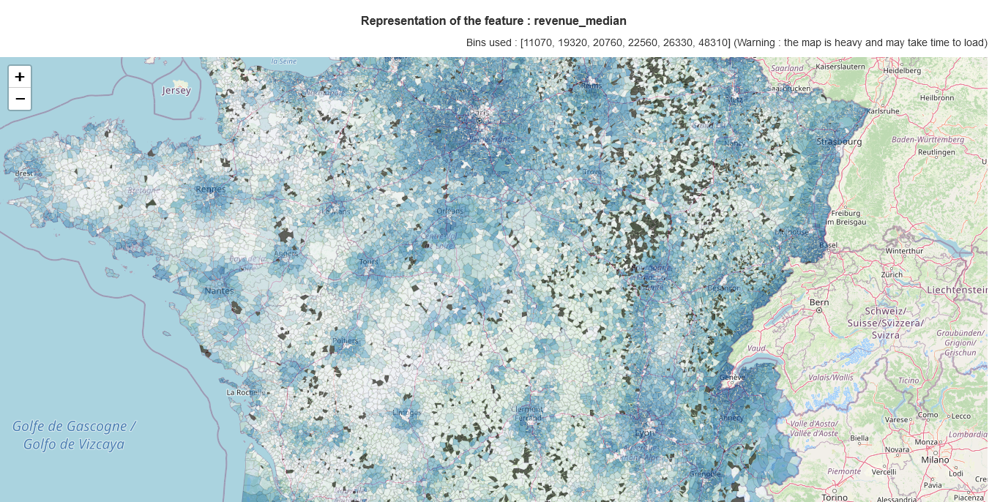

In [9]:
# Save map as png file 
png=map_france._to_png() # Save PNG bytes from folium in a variable 'png'
image = Image.open(io.BytesIO(png))  # create a PIL image object
image.save(r'{}.png'.format(feature), "PNG") # write to a png file
display(image)  # display image

# Save map as html file 
map_france.save(r'{}.html'.format(feature))

To plot and extract the all the different maps (age_median, revenue_median, Prix_m2, density) at once, we have created a loop that goes through all the features add apply all the code written before :

for feature in ['age_median', 'revenue_median','Prix_m2','density'] :
    # Define the title of the map
    title_text='Representation of the feature : {}'.format(feature)

    # Define the bins to plot the choropleth
    q0, q1, q2, q3, q4, q5 =  0, 0.25, 0.5, 0.75, 0.95, 1
    bins=[df[feature].quantile(q=q0),
          df[feature].quantile(q=q1),
          df[feature].quantile(q=q2),
          df[feature].quantile(q=q3),
          df[feature].quantile(q=q4),
          df[feature].quantile(q=q5)
         ]

    # Define a text to display the bins
    bin_text='Bins used : {}'.format(str(list(int(round(bin,0)) for bin in bins)))

    print(bin_text)

    # Initialize a map to the center of France
    map_france = folium.Map(location=[46.970810, 2.564210], zoom_start=7)

    # Create a choropleth object
    choropleth=folium.Choropleth(geo_data=communes_borders,
                      data=df,
                      columns=['Code INSEE',feature],
                      key_on='feature.properties.code',
                      bins=bins,
                      line_weight=0.1,
                      fill_opacity=0.6,
                      nan_fill_color='black',
                      nan_fill_opacity=0.6,
                      highlight=False,
                      smooth_factor=1,
                     )

    # Use the function defined previously to remove the legend from the map and add it to map_france
    folium_del_legend(choropleth).add_to(map_france)

    # Add a title to the map
    title_html = '''
                 <h3 align="center" style="font-size:16px"><b>{}</b></h3>
                 '''.format(title_text)
    map_france.get_root().html.add_child(folium.Element(title_html))

    # Display bin values and warning message because of the size of the map
    display_html = '''
                 <p align="right" style="font-size:10">{}  (Warning : the map is heavy and may take time to load)</p>
                 '''.format(bin_text) 
    map_france.get_root().html.add_child(folium.Element(display_html))

    map_france

    # Save map as png file 
    png=map_france._to_png() # Save PNG bytes from folium in a variable 'png'
    image = Image.open(io.BytesIO(png))  # create a PIL image object
    image.save(r'{}.png'.format(feature), "PNG") # write to a png file
    display(image)  # display image

    # Save map as html file 
    map_france.save(r'{}.html'.format(feature))

## Visualizing the distribution of the data

To better understand how the Communes are distributed along the studied features, we have built a small figure that show box plots of all features. The style of the box plot used here is called "Letter value plots".

(0, 6000)

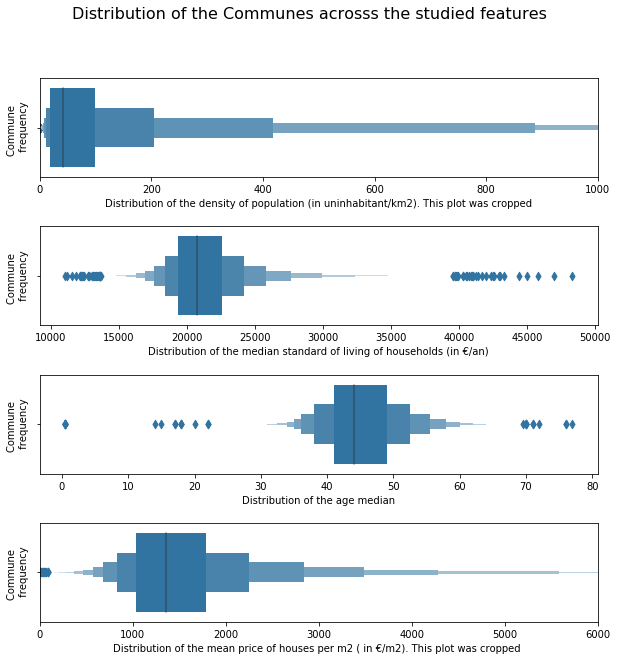

In [23]:
# Define subplots object
fig, (ax1, ax2, ax3, ax4) = plt.subplots(4, 1, figsize=(10,10) , gridspec_kw={'hspace': 0.5})

fig.suptitle('Distribution of the Communes acrosss the studied features', fontsize=16)

# Plot density
sns.boxenplot(df['density'],ax=ax1)
ax1.set_xlabel('Distribution of the density of population (in uninhabitant/km2). This plot was cropped')
ax1.set_ylabel('Commune \n frequency')
ax1.set_xlim(0,1000)

# Plot revenue_median
sns.boxenplot(df['revenue_median'],ax=ax2)
ax2.set_xlabel('Distribution of the median standard of living of households (in €/an)')
ax2.set_ylabel('Commune \n frequency')

# Plot age_median
sns.boxenplot(df['age_median'],ax=ax3)
ax3.set_xlabel('Distribution of the age median')
ax3.set_ylabel('Commune \n frequency')

# Plot Prix_m2
sns.boxenplot(df['Prix_m2'],ax=ax4)
ax4.set_xlabel('Distribution of the mean price of houses per m2 ( in €/m2). This plot was cropped ')
ax4.set_ylabel('Commune \n frequency')
ax4.set_xlim(0,6000)

## Let's filter the Communes to find a 'good place'

To find a good place to live or invest we can filter Communes along the different features. To do so let's  built a small tool with IpyWidgets library.

First we define a function that is going to filter the Commune with the features : 

In [24]:
def filter_result(density, revenue, age, price) :
    condition_1 = df['density']> density
    condition_2 = df['revenue_median']> revenue
    condition_3 = df['age_median']< age
    condition_4 = df['Prix_m2']< price
    print(df[condition_1 & condition_2 & condition_3 & condition_4].shape[0], 'result found')
    print('Parameters : filter_result(density=',density,', revenue=',revenue,', age=',age,', price=',price,')' )
    return df[condition_1 & condition_2 & condition_3 & condition_4].sort_values('Commune')

Secondly we define the widgets and the interact object that is going to call the previously defined funciton. Here is it, this tool now allows us to go filter through all the DataFrame with those little widgets : 

In [25]:
Wdensity=widgets.FloatSlider(value=2000,min=0, max=max(df.density), step=100, description='Min density')
Wrevenue=widgets.FloatSlider(value=18000,min=0, max=max(df.revenue_median), step=1000, description='Min revenue median')
Wage=widgets.FloatSlider(value=41,min=25, max=max(df.age_median), step=2, description='Max age median')
Wprice=widgets.FloatSlider(value=2300,min=1000, max=max(df.Prix_m2), step=100, description='Max price')

interact(filter_result, density=Wdensity, revenue=Wrevenue, age=Wage, price=Wprice);

interactive(children=(FloatSlider(value=2000.0, description='Min density', max=40168.579234972596, step=100.0)…

For this sutdy, we would like a place with :
    - a good density of population
    - households with a dencent enough standard of living (indicator of working class)
    - young enough population 
    - houses not too expensive
 Therefor we have chosen a combination of those values :
     - Density of population of at least 2000 people per km2
     - Standard of living of at least 18000€ per year
     - Population median age less than 41 years old
     - Mean house price per m2 less than 2300€

We have a result of 32 Communes that fit those criteria :

In [26]:
results=filter_result(density= 2000.0 , revenue= 18000.0 , age= 41.0 , price= 2300.0 )

32 result found
Parameters : filter_result(density= 2000.0 , revenue= 18000.0 , age= 41.0 , price= 2300.0 )


Let's where are they situated on a map :

In [27]:
# create map of France using latitude and longitude values
map_france = folium.Map(location=[46.970810, 2.564210], zoom_start=6)

to_plot=results

# instantiate a cluster object for the dataframe and add it to 'map_france'
communes_cluster = plugins.MarkerCluster().add_to(map_france)

# loop through the dataframe and add each data point to the mark cluster
for lat, lng, label, in zip(to_plot.lat, to_plot.lng, to_plot.Commune):
    if isinstance(label , str) :
        folium.Marker(
            location=[lat, lng],
            icon=None,
            popup=label,
        ).add_to(communes_cluster)

map_france

## Using Foursquare to get an insight on nightlife

After this first filtering, we now want to get an idea of the nightlife in those Communes. We will use the amount of bars as an indicator of nightlife. We will use Foursquare to inquire the amount of bers in the Communes. 

First we import the library to send request throught the Foursquare API, and define the variables:

In [33]:
import os
import requests
from dotenv import load_dotenv
load_dotenv()

True

In [34]:
# Initializing credentials
CLIENT_ID = os.getenv('FOURSQUARE_ID') # Foursquare ID
CLIENT_SECRET = os.getenv('FOURSQUARE_SECRET') # Foursquare Secret
VERSION = '20200901' # Foursquare API version

In [31]:
# Initializing parameters
LIMIT = 50 # 50 is the maximum results that the API provides
radius=3000 # We will serach for venues in 3000 meters of the Communes center
categoryId='4bf58dd8d48988d116941735' # is the category Id for 'bars' (see 'https://developer.foursquare.com/docs/build-with-foursquare/categories/')

Now let's request the Foursquare database, count the number of bars per Commune and add them in the dataframe 

In [36]:
# Create a new dataframe in which we will paste the results of the Forsquare requests
results_venues=results.copy()

# Create a loop that will request Foursquare for each locations
json_results_list=[]  
for i in range(0,results_venues.shape[0]) :
    # Define the position of the request
    lat=results.lat.iloc[i]
    lng=results.lng.iloc[i]

    # create the API request URL
    url = 'https://api.foursquare.com/v2/venues/search?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}&categoryId={}'.format(  
        CLIENT_ID, 
        CLIENT_SECRET, 
        VERSION, 
        lat, 
        lng, 
        radius, 
        LIMIT,
        categoryId)

    # make the GET request and add it to a list
    json_results = requests.get(url).json()
    json_results_list.append(json_results)

# Add the results of the request to the dataframe
results_venues['json_results']=json_results_list

# Count the amount of venues per response and add it in the 'nb_venues' column
list_len=[]
for i in range(results_venues.shape[0]) :
    list_len.append(len(results_venues['json_results'].iloc[i]['response']['venues']))
list_len    
results_venues['nb_venues']=list_len

Here are the results where 'nb_venues' represent the amount of bars venues.

In [37]:
results_venues[['Commune', 'population','N', 'nb_venues']].sort_values('nb_venues', ascending=False)

,Commune,population,N,nb_venues
4163,CLERMONT-FERRAND,142686.0,1382.0,50
23974,BREST,139342.0,2938.0,48
5125,LE MANS,142991.0,5398.0,35
9083,CROIX,21271.0,1093.0,32
7587,SAINT-MAURICE,14312.0,55.0,28
30777,LOOS,22076.0,817.0,28
1046,SAINT-ANDRE-LES-VERGERS,12116.0,436.0,26
9055,LE HAVRE,170352.0,4106.0,23
26375,POITIERS,87961.0,2087.0,22
26188,WATTRELOS,41341.0,1960.0,20


We can conclude that after all the filtering Clermond-Ferrand stand out. In an another notebook, we will try to analyse and try to predict the price of houses in Clermont-Ferrand. 